# Debug exploration of (SwissInfo) WW2 Radio Bulletins

This notebook aims to perform a first rougth exploration of the the data at hand, for the KB and SwissInfo radio bulletins.



### Imports

In [17]:
import os
import requests
from bs4 import BeautifulSoup
from pypdf import PdfReader
import json
import pdfplumber
from PIL import Image, ImageDraw, ImageFont
from pdf2image import convert_from_path
import fitz 

### Functions

In [2]:
def coords_to_xy(coords):
    return [coords[0], coords[1], coords[0]+coords[2], coords[1]+coords[3]]

In [32]:
def draw_box_on_img(base_img_path, coords_xy, img = None, width=10, text = None, color='red'):
    if not img:
        img = Image.open(base_img_path)  
    img_draw = ImageDraw.Draw(img)
    img_draw.rectangle(coords_xy, outline=color, width=width)

    if text is not None: 
        img_draw.text((coords_xy[0], coords_xy[1]),text,(0,0,0))
    return img

In [4]:
def scale_coords(coords, curr_res, des_res):
    return [c*int(des_res)/int(curr_res) for c in coords]

## SwissInfo WWII Bulletins - Text-embedded PDFs

SwissInfo's OCR data is already contained within the PDF files. 
In order to process them, we first need extract it in XML or any other format that we know how to work with.

In [5]:
swissinfo_data_path = "/mnt/project_impresso/original/SWISSINFO/WW2-SOC-bulletins/"
si_ocr_data_path = os.path.join(swissinfo_data_path, 'ww2-PDF')
si_excel_path = os.path.join(swissinfo_data_path, 'SWI_Konkordanz_pdf-neu.xlsx')

si_ocr_data_path

'/mnt/project_impresso/original/SWISSINFO/WW2-SOC-bulletins/ww2-PDF'

In [6]:
swissinfo_filenames = os.listdir(si_ocr_data_path)
swissinfo_filenames[:5]

['SRI_XY_CJ_19450712_FR.pdf',
 'SRI_XY_CJ_19410312_FR.pdf',
 'SRI_XY_CJ_19440307_FR.pdf',
 'SRI_XY_CJ_19410322_DE.pdf',
 'SRI_XY_CJ_19451023_FR.pdf']

## Playing around with various OCR text extraction libraries

In [7]:
test_img_path = os.path.join(si_ocr_data_path, swissinfo_filenames[0])
test_img_path

'/mnt/project_impresso/original/SWISSINFO/WW2-SOC-bulletins/ww2-PDF/SRI_XY_CJ_19450712_FR.pdf'

### 1. pypdf

In [7]:
reader = PdfReader(test_img_path)
number_of_pages = len(reader.pages)
page = reader.pages[0]
text = page.extract_text()

number_of_pages

2

In [8]:
page

{'/Type': '/Page',
 '/MediaBox': [0, 0, 610.08, 849.36],
 '/Resources': {'/XObject': {'/Im001': {'/Subtype': '/Image',
    '/Width': 1,
    '/Height': 1,
    '/ColorSpace': '/DeviceGray',
    '/BitsPerComponent': 8,
    '/OC': {'/Type': '/OCMD',
     '/OCGs': [IndirectObject(20, 0, 139836059727504)],
     '/P': '/AllOff'}},
   '/Im002': {'/Subtype': '/Image',
    '/Width': 1271,
    '/Height': 1770,
    '/ColorSpace': '/DeviceRGB',
    '/BitsPerComponent': 8,
    '/Interpolate': True,
    '/OC': {'/Type': '/OCG', '/Name': 'Background'},
    '/Filter': '/JPXDecode'},
   '/Im003': {'/Subtype': '/Image',
    '/Width': 848,
    '/Height': 1180,
    '/ColorSpace': '/DeviceRGB',
    '/BitsPerComponent': 8,
    '/SMask': {'/Subtype': '/Image',
     '/Width': 2542,
     '/Height': 3539,
     '/ColorSpace': '/DeviceGray',
     '/BitsPerComponent': 1,
     '/Decode': [1, 0],
     '/Interpolate': True,
     '/Filter': '/JBIG2Decode'},
    '/OC': {'/Type': '/OCG', '/Name': 'Text Color'},
    '/Fil

In [9]:
print(text)

Chronique de la journée.       12 juillet 1945. Seitz. 
Mesdames et Messieurs, 
Veuillez écouter notre chronique de la journée. 
Le ministèèe des affaires étrangères de Grande-Bretagne a remis 
au Quai d'Orsay une note proposant que la conférence de Tanger soit 
ajournée jusque ce que le gouvernement britannique ait pu examiner la 
question de la participation soviétique» 
les adminsitrations militaires Kfe britannique et américaine assume- 
ront dès aujourd'hui la charge d'environ 1.650.000 Berlinois à la suite 
de l'accord intervenu à la commission interalliée, ^es décisions de 
celle-ci ont été prises à l'unanimité. Les experts alliés prôparsHKfexent 
un plan pour assurer la ravitaillement en vivres de la population. Tant 
que les moyens de transport ne seront pas améliorés dans les zÈnes an- 
glaise et américaine d'occupation, les Russes contribueront à participer 
au ravitaillement des habitants de ces zones. Une réunion devait se 
dérouler aujourd'hui pour examiner la politique à

#### Comments

- Good thing is that text is already rebuilt and formatted perfectly. 
- It would be necessary to look more at the documentation to know exactly how to interpret and extract information from the pages object.
- However, it does seem like we are loosing coordinates/placement information which could be problematic. 
- To be considered further, also trying out other similar tools

### 2. [pdfplumber](https://github.com/jsvine/pdfplumber)

In [10]:
with pdfplumber.open(test_img_path) as pdf:
    for page in pdf.pages:
        print(page.extract_text())

Chronique de la journée. 12 juillet 1945. Seitz.
Mesdames et Messieurs,
Veuillez écouter notre chronique de la journée.
Le ministèèe des affaires étrangères de Grande-Bretagne a remis
au Quai d'Orsay une note proposant que la conférence de Tanger soit
ajournée jusque ce que le gouvernement britannique ait pu examiner la
question de la participation soviétique»
les adminsitrations militaires Kfe britannique et américaine assume-
ront dès aujourd'hui la charge d'environ 1.650.000 Berlinois à la suite
de l'accord intervenu à la commission interalliée, ^es décisions de
celle-ci ont été prises à l'unanimité. Les experts alliés prôparsHKfexent
un plan pour assurer la ravitaillement en vivres de la population. Tant
que les moyens de transport ne seront pas améliorés dans les zÈnes an-
glaise et américaine d'occupation, les Russes contribueront à participer
au ravitaillement des habitants de ces zones. Une réunion devait se
dérouler aujourd'hui pour examiner la politique à suivre en matière de

In [11]:
with pdfplumber.open(test_img_path) as pdf:
    first_page = pdf.pages[0]
    print(first_page)
    print(first_page.chars[0])

<Page:1>
{'matrix': (610.08, 0.0, 0.0, 849.36, 32212.224000000002, 691650.8352000001), 'fontname': 'Courier', 'adv': 7.066799999999999, 'upright': True, 'x0': 32212.224000000002, 'y0': 689508.7492800001, 'x1': 36523.537344000004, 'y1': 700550.42928, 'width': 4311.313344000002, 'height': 11041.679999999935, 'size': 11041.679999999935, 'mcid': None, 'tag': None, 'object_type': 'char', 'page_number': 1, 'ncs': 'DeviceGray', 'text': 'C', 'stroking_color': None, 'stroking_pattern': None, 'non_stroking_color': None, 'non_stroking_pattern': None, 'top': -699701.06928, 'bottom': -688659.3892800001, 'doctop': -699701.06928}


This library seems to specifically have also a command-line interface

In [12]:
! pdfplumber < /mnt/project_impresso/original/SWISSINFO/WW2-SOC-bulletins/ww2-PDF/SRI_XY_CJ_19450712_FR.pdf > SRI_XY_CJ_19450712_FR_test.json --format json

In [13]:
txt_lines = []
with pdfplumber.open(test_img_path) as pdf:
    for page in pdf.pages:
        print(page.page_number)
        txt_lines.append(page.extract_text_lines())
        print(page.extract_text_lines())
        print(page.extract_text())

1
[{'text': 'Chronique de la journée. 12 juillet 1945. Seitz.', 'x0': 32212.224000000002, 'top': -699701.06928, 'x1': 316411.282462176, 'bottom': -688659.3892800001, 'chars': [{'matrix': (610.08, 0.0, 0.0, 849.36, 32212.224000000002, 691650.8352000001), 'fontname': 'Courier', 'adv': 7.066799999999999, 'upright': True, 'x0': 32212.224000000002, 'y0': 689508.7492800001, 'x1': 36523.537344000004, 'y1': 700550.42928, 'width': 4311.313344000002, 'height': 11041.679999999935, 'size': 11041.679999999935, 'mcid': None, 'tag': None, 'object_type': 'char', 'page_number': 1, 'ncs': 'DeviceGray', 'text': 'C', 'stroking_color': None, 'stroking_pattern': None, 'non_stroking_color': None, 'non_stroking_pattern': None, 'top': -699701.06928, 'bottom': -688659.3892800001, 'doctop': -699701.06928}, {'matrix': (610.08, 0.0, 0.0, 849.36, 36523.537344000004, 691650.8352000001), 'fontname': 'Courier', 'adv': 7.066799999999999, 'upright': True, 'x0': 36523.537344000004, 'y0': 689508.7492800001, 'x1': 40834.85

In [14]:
txt_lines

[[{'text': 'Chronique de la journée. 12 juillet 1945. Seitz.',
   'x0': 32212.224000000002,
   'top': -699701.06928,
   'x1': 316411.282462176,
   'bottom': -688659.3892800001,
   'chars': [{'matrix': (610.08,
      0.0,
      0.0,
      849.36,
      32212.224000000002,
      691650.8352000001),
     'fontname': 'Courier',
     'adv': 7.066799999999999,
     'upright': True,
     'x0': 32212.224000000002,
     'y0': 689508.7492800001,
     'x1': 36523.537344000004,
     'y1': 700550.42928,
     'width': 4311.313344000002,
     'height': 11041.679999999935,
     'size': 11041.679999999935,
     'mcid': None,
     'tag': None,
     'object_type': 'char',
     'page_number': 1,
     'ncs': 'DeviceGray',
     'text': 'C',
     'stroking_color': None,
     'stroking_pattern': None,
     'non_stroking_color': None,
     'non_stroking_pattern': None,
     'top': -699701.06928,
     'bottom': -688659.3892800001,
     'doctop': -699701.06928},
    {'matrix': (610.08,
      0.0,
      0.0,
    

In [15]:
pdf.pages[0].height, pdf.pages[0].width

(849.36, 610.08)

In [17]:
pdf.draw_line(first_l, stroke_width=1)

AttributeError: 'PDF' object has no attribute 'draw_line'

In [14]:
first_l = txt_lines[0][0]
coords_xy_first_line = [int(first_l['x0']), int(first_l['top']), int(first_l['x1']), int(first_l['bottom'])]

img = convert_from_path(test_img_path)
img

[<PIL.PpmImagePlugin.PpmImageFile image mode=RGB size=1695x2360>,
 <PIL.PpmImagePlugin.PpmImageFile image mode=RGB size=1686x2351>]

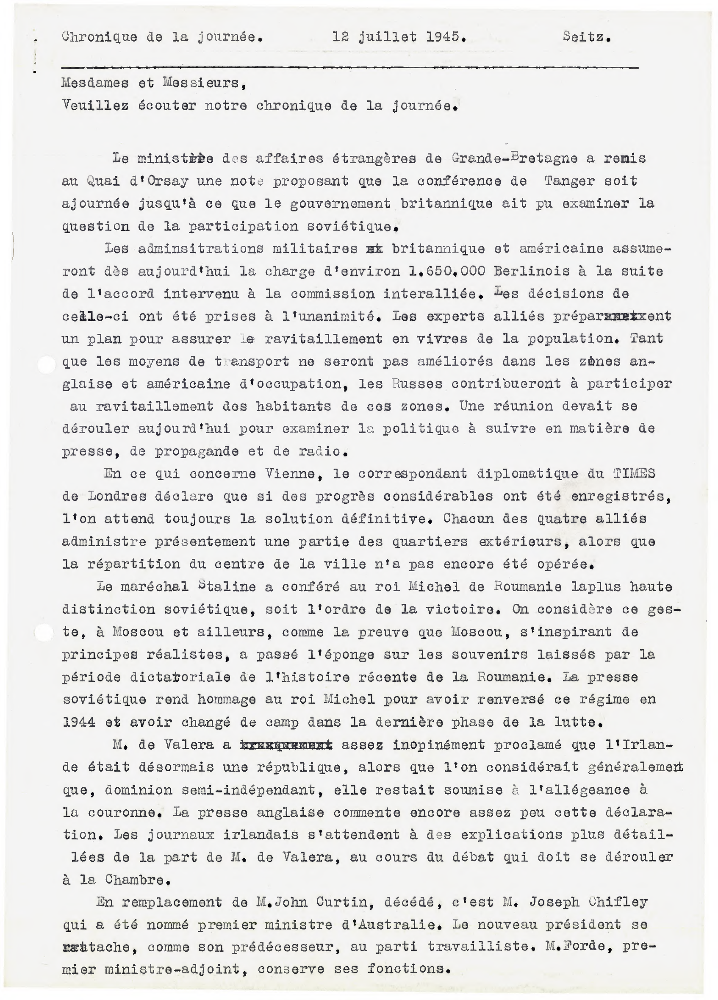

In [15]:
draw_box_on_img(test_img_path, coords_xy_first_line, img[0])

#### Comments

- There seems to be more information, and in particular the lines and tokens whiche are nice
- However the coordinates seem very weird and their [`draw_line`](https://github.com/jsvine/pdfplumber?tab=readme-ov-file#drawing-methods) method does not seem to work
- documentation is limited, it would need further explorations

### 2. [PyMuPDF](https://pypi.org/project/PyMuPDF/) (fitz)

In [8]:
doc = fitz.open(test_img_path)

block_with_lines = {}
# Extract text and bounding boxes from each page
for page_number in range(len(doc)):
    page = doc.load_page(page_number)  # Load a specific page
    blocks = page.get_text("dict")["blocks"]  # Extract text as a dictionary
    block_with_lines[page_number] = []
    for block in blocks:
        if "lines" in block:
            block_with_lines[page_number].append(block)
            for line in block["lines"]:
                for span in line["spans"]:
                    text = span["text"]  # Extracted text
                    bbox = span["bbox"]  # Bounding box (x0, y0, x1, y1)
                    print(f"Text: {text}, BBox: {bbox}")


Text: Chronique, BBox: (52.79999923706055, 22.92397689819336, 116.4012222290039, 39.16097640991211)
Text:  , BBox: (116.4012222290039, 22.92397689819336, 125.0412826538086, 39.16097640991211)
Text: de, BBox: (125.0412826538086, 22.92397689819336, 137.7615203857422, 39.16097640991211)
Text:  , BBox: (137.7615203857422, 22.92397689819336, 146.40158081054688, 39.16097640991211)
Text: la, BBox: (146.40158081054688, 22.92397689819336, 160.08120727539062, 39.16097640991211)
Text:  , BBox: (160.08120727539062, 22.92397689819336, 168.24156188964844, 39.16097640991211)
Text: journée., BBox: (168.24156188964844, 22.92397689819336, 222.47959899902344, 39.16097640991211)
Text:  , BBox: (222.47959899902344, 22.92397689819336, 230.87942504882812, 39.16097640991211)
Text:       , BBox: (230.87942504882812, 22.92397689819336, 282.7198486328125, 39.16097640991211)
Text: 12, BBox: (282.7198486328125, 22.92397689819336, 296.15924072265625, 39.16097640991211)
Text:  , BBox: (296.15924072265625, 22.9239768

In [9]:
page_1_text = doc.load_page(0).get_text()
page_1_text

"Chronique de la journée.       12 juillet 1945. Seitz. \nMesdames et Messieurs, \nVeuillez écouter notre chronique de la journée. \nLe ministèèe des affaires étrangères de Grande-Bretagne a remis \nau Quai d'Orsay une note proposant que la conférence de Tanger soit \najournée jusque ce que le gouvernement britannique ait pu examiner la \nquestion de la participation soviétique» \nles adminsitrations militaires Kfe britannique et américaine assume- \nront dès aujourd'hui la charge d'environ 1.650.000 Berlinois à la suite \nde l'accord intervenu à la commission interalliée, ^es décisions de \ncelle-ci ont été prises à l'unanimité. Les experts alliés prôparsHKfexent \nun plan pour assurer la ravitaillement en vivres de la population. Tant \nque les moyens de transport ne seront pas améliorés dans les zÈnes an- \nglaise et américaine d'occupation, les Russes contribueront à participer \nau ravitaillement des habitants de ces zones. Une réunion devait se \ndérouler aujourd'hui pour examine

In [10]:
page_1_dict = doc.load_page(0).get_text("dict")
page_1_dict

{'width': 610.0800170898438,
 'height': 849.3599853515625,
 'blocks': [{'number': 0,
   'type': 1,
   'bbox': (0.0, 0.0, 610.0800170898438, 849.3599853515625),
   'width': 1271,
   'height': 1770,
   'ext': 'png',
   'colorspace': 3,
   'xres': 96,
   'yres': 96,
   'bpc': 8,
   'transform': (610.0800170898438, 0.0, -0.0, 849.3599853515625, 0.0, 0.0),
   'size': 1574784,
   'image': b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x04\xf7\x00\x00\x06\xea\x08\x02\x00\x00\x00"\xaf\x02\xf9\x00\x00\x00\tpHYs\x00\x00\x0e\xc4\x00\x00\x0e\xc4\x01\x95+\x0e\x1b\x00\x18\x072IDATx\x9c\xec\xbd\xeb\x92#\xb9\x92\xa07\xef\xff\x06+\x99fe\xb6\xbb?\xa4\x1fz\x01\x99d\xb2\x99\xd5\x8e4\xbb\xb3;\xda3}NwW\xd7=/\xbc\xc4\xfdFf\x92\xcc\x94\x03\x8e\x8b\x03p \x10AfU\x9f\x9e\n\xf3\xcef\x91\xc1 \x02\x018\xfcsw\x00\x7f\xf3\xba\xe2x\x11\xf2r\x01yq\xe5\xf5\xf5\xa2>\x15"\xff)N;\xbf\xf8\x82\xef\x93\x8f.J.R\xd4?\xf1\x9a//V.D\xceB\xd4\x05N\x17*\xafJ\xd49\xafg\xf8\x9dW\xf3\x9b\x17W\xce\x97\x97\xf3\xf9\xe5t\xbe\x08\xb9\xa8\x12

In [11]:
block_with_lines

{0: [{'number': 2,
   'type': 0,
   'bbox': (52.79999923706055,
    21.064977645874023,
    526.4390869140625,
    39.16097640991211),
   'lines': [{'spans': [{'size': 12.373924255371094,
       'flags': 8,
       'char_flags': 0,
       'font': 'Courier',
       'color': 0,
       'ascender': 0.9319999814033508,
       'descender': -0.31700000166893005,
       'text': 'Chronique',
       'origin': (52.79999923706055, 35.03997802734375),
       'bbox': (52.79999923706055,
        22.92397689819336,
        116.4012222290039,
        39.16097640991211)},
      {'size': 13.68215274810791,
       'flags': 8,
       'char_flags': 0,
       'font': 'Courier',
       'color': 0,
       'ascender': 0.9319999814033508,
       'descender': -0.31700000166893005,
       'text': ' ',
       'origin': (116.4012222290039, 35.03997802734375),
       'bbox': (116.4012222290039,
        22.92397689819336,
        125.0412826538086,
        39.16097640991211)},
      {'size': 11.738935470581055,
       

In [12]:
first_block = block_with_lines[0][0]#['lines'][0]['spans'][0]
print(first_block)
first_block_bbox = first_block['bbox']

first_word = first_block['lines'][0]['spans'][0]
first_word_bbox = first_word['bbox']
first_word_text = first_word['text']

{'number': 2, 'type': 0, 'bbox': (52.79999923706055, 21.064977645874023, 526.4390869140625, 39.16097640991211), 'lines': [{'spans': [{'size': 12.373924255371094, 'flags': 8, 'char_flags': 0, 'font': 'Courier', 'color': 0, 'ascender': 0.9319999814033508, 'descender': -0.31700000166893005, 'text': 'Chronique', 'origin': (52.79999923706055, 35.03997802734375), 'bbox': (52.79999923706055, 22.92397689819336, 116.4012222290039, 39.16097640991211)}, {'size': 13.68215274810791, 'flags': 8, 'char_flags': 0, 'font': 'Courier', 'color': 0, 'ascender': 0.9319999814033508, 'descender': -0.31700000166893005, 'text': ' ', 'origin': (116.4012222290039, 35.03997802734375), 'bbox': (116.4012222290039, 22.92397689819336, 125.0412826538086, 39.16097640991211)}, {'size': 11.738935470581055, 'flags': 8, 'char_flags': 0, 'font': 'Courier', 'color': 0, 'ascender': 0.9319999814033508, 'descender': -0.31700000166893005, 'text': 'de', 'origin': (125.0412826538086, 35.03997802734375), 'bbox': (125.0412826538086, 

In [71]:
img[0].height, img[0].width

(846, 606)

In [86]:
thrid_block = block_with_lines[0][2]#['lines'][0]['spans'][0]
print(thrid_block)
thrid_block_bbox = thrid_block['bbox']

rdm_word = thrid_block['lines'][0]['spans'][0]
rdm_word_bbox = rdm_word['bbox']
rdm_word_text = rdm_word['text']

fifth_block = block_with_lines[0][4]#['lines'][0]['spans'][0]
print(fifth_block)
fifth_block_bbox = fifth_block['bbox']

rdm_word_2 = fifth_block['lines'][0]['spans'][0]
rdm_word_2_bbox = rdm_word_2['bbox']
rdm_word_2_text = rdm_word_2['text']

{'number': 4, 'type': 0, 'bbox': (52.79999923706055, 81.24398803710938, 396.60296630859375, 97.48098754882812), 'lines': [{'spans': [{'size': 12.306819915771484, 'flags': 8, 'char_flags': 0, 'font': 'Courier', 'color': 0, 'ascender': 0.9319999814033508, 'descender': -0.31700000166893005, 'text': 'Veuillez', 'origin': (52.79999923706055, 93.3599853515625), 'bbox': (52.79999923706055, 81.24398803710938, 108.72286224365234, 97.48098754882812)}, {'size': 14.2407865524292, 'flags': 8, 'char_flags': 0, 'font': 'Courier', 'color': 0, 'ascender': 0.9319999814033508, 'descender': -0.31700000166893005, 'text': ' ', 'origin': (108.72285461425781, 93.3599853515625), 'bbox': (108.72285461425781, 81.24398803710938, 118.08285522460938, 97.48098754882812)}, {'size': 12.31025218963623, 'flags': 8, 'char_flags': 0, 'font': 'Courier', 'color': 0, 'ascender': 0.9319999814033508, 'descender': -0.31700000166893005, 'text': 'écouter', 'origin': (118.08285522460938, 93.3599853515625), 'bbox': (118.08285522460

In [80]:
img = convert_from_path(test_img_path, size=(page_1_dict['width'], page_1_dict['height']))

In [58]:
img[0].height, img[0].width

(846, 606)

Chronique
Veuillez
au


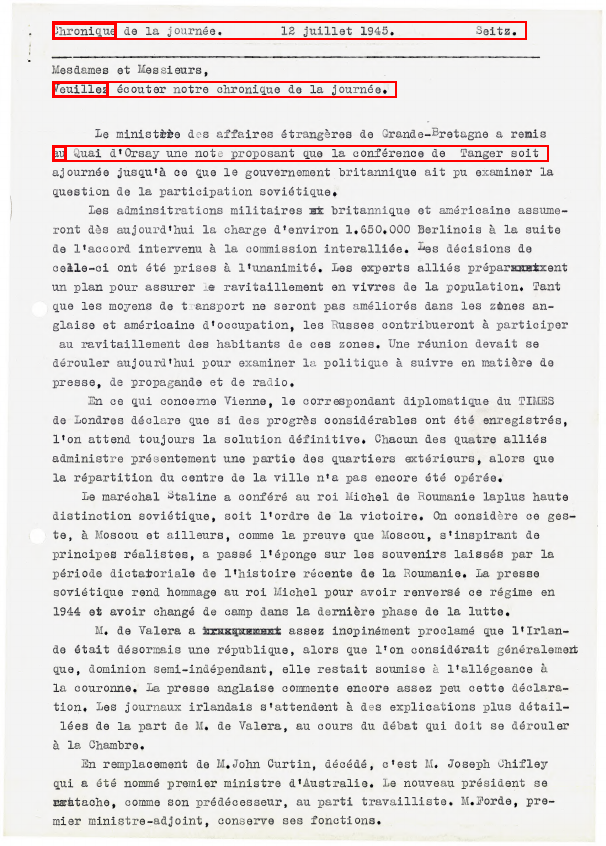

In [87]:
print(first_word_text)
draw_box_on_img(test_img_path, first_block_bbox, img[0], width=2)
draw_box_on_img(test_img_path, first_word_bbox, img[0], width=3)
print(rdm_word_text)
draw_box_on_img(test_img_path, thrid_block_bbox, img[0], width=2)
draw_box_on_img(test_img_path, rdm_word_bbox, img[0], width=3)
print(rdm_word_2_text)
draw_box_on_img(test_img_path, fifth_block_bbox, img[0], width=2)
draw_box_on_img(test_img_path, rdm_word_2_bbox, img[0], width=3)

#### Comments:
- this seems to match our needs much better. 
- It looks like we can extract all coordinates. 
- However, what constitutes a block or a line seems to be a little hard to identify 

In [ ]:
with open("test_pdf_out_ocr.json", mode="w") as fout:
    json.dump(page_1_dict, fout)

#### Fetching all blocks

In [13]:
block_with_lines

{0: [{'number': 2,
   'type': 0,
   'bbox': (52.79999923706055,
    21.064977645874023,
    526.4390869140625,
    39.16097640991211),
   'lines': [{'spans': [{'size': 12.373924255371094,
       'flags': 8,
       'char_flags': 0,
       'font': 'Courier',
       'color': 0,
       'ascender': 0.9319999814033508,
       'descender': -0.31700000166893005,
       'text': 'Chronique',
       'origin': (52.79999923706055, 35.03997802734375),
       'bbox': (52.79999923706055,
        22.92397689819336,
        116.4012222290039,
        39.16097640991211)},
      {'size': 13.68215274810791,
       'flags': 8,
       'char_flags': 0,
       'font': 'Courier',
       'color': 0,
       'ascender': 0.9319999814033508,
       'descender': -0.31700000166893005,
       'text': ' ',
       'origin': (116.4012222290039, 35.03997802734375),
       'bbox': (116.4012222290039,
        22.92397689819336,
        125.0412826538086,
        39.16097640991211)},
      {'size': 11.738935470581055,
       

In [14]:
blocks_bboxes = {pg: [b['bbox'] for b in pg_blocks] for pg, pg_blocks in block_with_lines.items()}

blocks_f_words = {pg: [b['lines'][0]['spans'][0] for b in pg_blocks] for pg, pg_blocks in block_with_lines.items()}

blocks_f_word_bboxes = {pg: [f_w['bbox'] for f_w in block_f_words] for pg, block_f_words in blocks_f_words.items()}
blocks_f_word_text = {pg: [f_w['text'] for f_w in block_f_words] for pg, block_f_words in blocks_f_words.items()}

In [15]:
print(f"blocks_bboxes: \n {blocks_bboxes} \n")
print(f"blocks_f_words: \n {blocks_f_words} \n")
print(f"blocks_f_word_bboxes: \n {blocks_f_word_bboxes} \n")
print(f"blocks_f_word_text: \n {blocks_f_word_text} \n")

blocks_bboxes: 
 {0: [(52.79999923706055, 21.064977645874023, 526.4390869140625, 39.16097640991211), (51.84000015258789, 62.04397201538086, 216.5970458984375, 78.28097534179688), (52.79999923706055, 81.24398803710938, 396.60296630859375, 97.48098754882812), (95.76000213623047, 126.12399291992188, 556.4382934570312, 142.36099243164062), (52.560001373291016, 145.32400512695312, 548.9979858398438, 161.56100463867188), (52.79999923706055, 164.52401733398438, 564.3551635742188, 180.76101684570312), (53.279998779296875, 183.96395874023438, 346.1996154785156, 200.20095825195312), (89.27999877929688, 202.68399047851562, 578.5194091796875, 218.92098999023438), (53.279998779296875, 222.12399291992188, 571.0814819335938, 238.36099243164062), (53.040000915527344, 241.08401489257812, 542.0486450195312, 257.3210144042969), (53.279998779296875, 260.0439758300781, 578.04541015625, 276.2809753417969), (52.08000183105469, 279.4839782714844, 570.84228515625, 295.7209777832031), (53.52000045776367, 298.68

In [35]:
img = convert_from_path(test_img_path, size=(page_1_dict['width'], page_1_dict['height']))

Block 0, first word = Chronique
Block 1, first word = Mesdames
Block 2, first word = Veuillez
Block 3, first word = Le
Block 4, first word = au
Block 5, first word = ajournée
Block 6, first word = question
Block 7, first word = les
Block 8, first word = ront
Block 9, first word = de
Block 10, first word = celle-ci
Block 11, first word = un
Block 12, first word = que
Block 13, first word = glaise
Block 14, first word = au
Block 15, first word = dérouler
Block 16, first word = presse,
Block 17, first word = En
Block 18, first word = de
Block 19, first word = l'on
Block 20, first word = administre
Block 21, first word = la
Block 22, first word = Le
Block 23, first word = distinction
Block 24, first word = te,
Block 25, first word = principes
Block 26, first word = période
Block 27, first word = soviétique
Block 28, first word = 1944
Block 29, first word = M,
Block 30, first word = de
Block 31, first word = que,
Block 32, first word = la
Block 33, first word = tion.
Block 34, first word = 

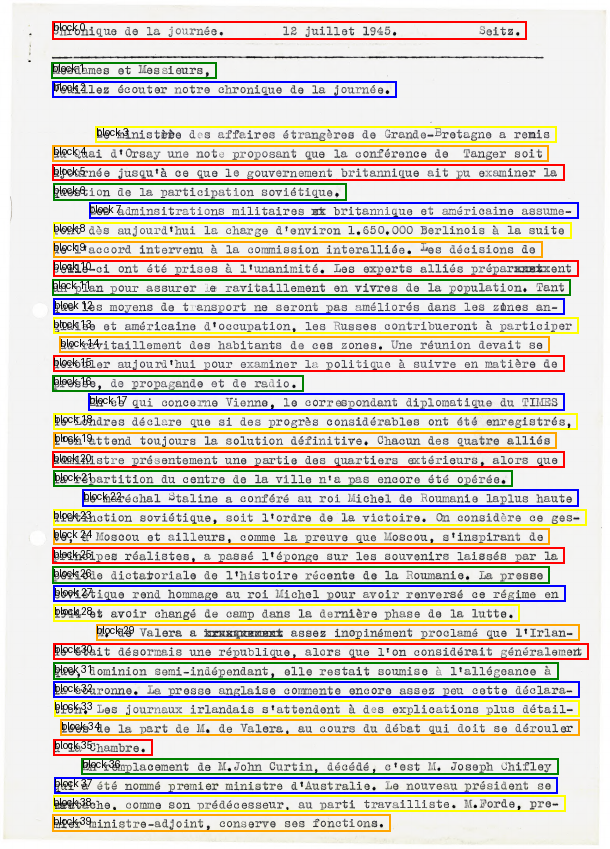

In [36]:
colors = ["red", 'green', 'blue', 'yellow', 'orange']
for pg, block_bboxes in blocks_bboxes.items():
    for block_id, bbox in enumerate(block_bboxes):
        txt = f"block {block_id}"
        print(f"Block {block_id}, first word = {blocks_f_word_text[pg][block_id]}")
        color_id = block_id%len(colors)
        img[0] = draw_box_on_img(test_img_path, bbox, img[0], width=2, text=txt, color=colors[color_id])
    break

img[0]

Indeed, one block here corresponds to one line exactly. 
As a result, we cannot group the various paragraphs into blocks except by using the line offset as information. 
This would be a heuristic, which would likely not hold well with the very varied formats and displays.